In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
import scipy.io
import random
import math
import itertools
import pandas as pd
from numpy import linalg as LA
import warnings
warnings.filterwarnings("ignore")

# Función para convertir un vector fila a vector columna.
def columna(vector):
    return np.array(np.matrix(vector)).T

# Análisis de componentes principales

## a) Media de Procrustes y alinear landmarks

In [2]:
dataDir = "Faces/markings/"
data = []
for file in os.listdir(dataDir) :
    data.append(scipy.io.loadmat(dataDir+file))

Text(0, 0.5, 'y')

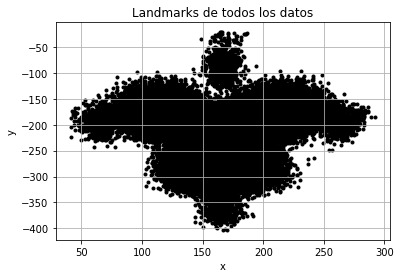

In [3]:
# Creamos una lista en la que se guardaran todos los datos, y la llenamos
datos = []

for i in range(len(data)):
    datos.append(data[i]['faceCoordinatesUnwarped'])

plt.figure()
plt.grid()
for i in range(len(datos)):
    plt.scatter(datos[i][:,0], -datos[i][:,1], color='black', marker='.')
plt.title('Landmarks de todos los datos')
plt.xlabel('x')
plt.ylabel('y')

Text(0, 0.5, 'y')

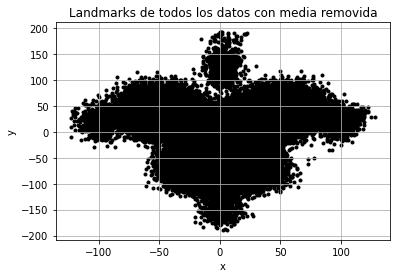

In [4]:
# Se unifican todos los datos en una sola matriz de (974*67)x2
todos = np.vstack(datos)

# Parte real de los datos (coordsX)
wr = columna(todos[:,0])

# Parte imaginaria de los datos (coordsY)
wi = columna(todos[:,1])

# Se remueve la media de cada forma
mediaWr = float(sum(wr))/len(wr)
mediaWi = float(sum(wi))/len(wi)

# Removemos la media de los datos
wr_sinmedia = wr - mediaWr
wi_sinmedia = wi - mediaWi

# Graficamos los landmarks con la media removida
plt.figure()
plt.grid()
plt.scatter(wr_sinmedia, -wi_sinmedia, color='black', marker='.')
plt.title('Landmarks de todos los datos con media removida')
plt.xlabel('x')
plt.ylabel('y')

In [5]:
# Encontramos la media de Procrustes
S = np.zeros((len(datos[0]), len(datos[0])))
w_complejo = np.zeros((len(datos[0]), 1), dtype=complex)

# Construimos la matriz S
primero = 1
for i in range(len(datos)):
    dato = datos[i]
    for j in range(len(dato)):
        w_complejo[j] = complex(dato[j][0], dato[j][1])
    if primero==1:
        S = w_complejo@np.transpose(np.conj(w_complejo))
        primero = 0
    else:
        S = S + w_complejo@np.transpose(np.conj(w_complejo))

Text(0, 0.5, 'y')

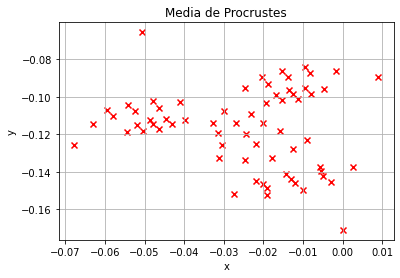

In [6]:
# w es un arreglo con los valores propios
# v es una matriz cuyas columnas son los vectores propios
# el valor propio en w[i] está asociado a la columna v[:,i]
w, v = LA.eig(S)

maximo = np.abs(np.amax(w))
indice = 0

for i in range(len(w)):
    if np.abs(w[i]) == maximo:
        indice = i

# Media de Procrustes
mediaProc = v[:, indice]
coordsX = mediaProc.real
coordsY = mediaProc.imag

plt.figure()
plt.grid()
plt.scatter(coordsY, -coordsX, color='red', marker='x')
plt.title('Media de Procrustes')
plt.xlabel('x')
plt.ylabel('y')

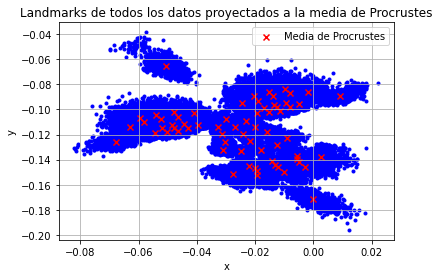

In [7]:
# Ahora vamos a alinear los landmarks de todos los datos a la media de Procrustes.

# Creamos una lista para guardar en en ella los datos ajustados a la media de Procrustes
datos_media = []

# Este es el vector que vamos a ajustar a la media de Procrustes
w_tr_comp = np.zeros((len(datos[0]), 1), dtype=complex)

for i in range(len(datos)):
    dato = datos[i]
    for j in range(len(dato)):
        w_tr_comp[j] = complex(dato[j][0], dato[j][1])

    # Se proyectan los landmarks a la media de Procrustes-
    wp_tr = w_tr_comp*((np.transpose(np.conj(w_tr_comp))@mediaProc)/((np.transpose(np.conj(w_tr_comp))@w_tr_comp)))

    # Se agrega cada landmark alineado a la lista.
    datos_media.append(wp_tr)

    # Separamos las coordenadas X y las coordenadas Y
    wp_tr_r = wp_tr.real
    wp_tr_i = wp_tr.imag

    # Gráfica
    plt.scatter(wp_tr_i, -wp_tr_r, color='blue', marker='.')

plt.grid()
plt.scatter(coordsY, -coordsX, color='red', marker='x', label='Media de Procrustes')
plt.title('Landmarks de todos los datos proyectados a la media de Procrustes')
plt.xlabel('x')
plt.ylabel('y')
plt.legend()

## b) Vector de 2n por cada expresión facial
La primera característica corresponde a las componente horizontal del landmark 1 de la expresión facial.
La segunda característica corresponde a las componente vertical del landmark 1 de la expresión facial.
Repita este procedimiento para el resto de los landmarks.

In [8]:
# Se crea una matriz en la que cada columna corresponderá a cada vector de caracterísitcas de cada expresión facial
matriz_carac = np.zeros((2*len(datos_media[0]), len(datos_media)))

# Se llena la matriz con el contendio de cada vector, teniendo en cuenta la consideración expresada arriba.
for i in range(len(datos_media)):
    dato = datos_media[i]
    datoNew = np.zeros((2*len(dato), 1))
    for j in range(len(dato)):
        datoNew[j*2] = dato.real[j]
        datoNew[j*2+1] = dato.imag[j]
    matriz_carac[:,i] = columna(datoNew)

## c) Encontrar los vectores principales

Tome los tres primeros vectores principales (es decir, los vectores propios asociados a los tres valores propios más grandes de la matriz de covarianza), y grafíquelos como si fueran expresiones faciales.  Indique la varianza que aporta cada uno de estos vectores para representar los datos (es decir, el valor propio asociado a cada vector). Interprete los resultados, teniendo en cuenta que estos vectores se pueden ver como bases que capturan la variabilidad de todas las expresiones faciales.

In [9]:
# El primer paso es encontrar una estimación de la media de los datos. Esta media va a tener la misma dimensión que cada dato x_i (cada columna de la matriz matriz_carac)
mu = np.zeros((np.shape(matriz_carac)[0], 1))

for i in range(np.shape(matriz_carac)[1]):
    x = columna(matriz_carac[:,i])
    mu = mu + x

mu = (1/np.shape(matriz_carac)[1])*mu
print(f'Media mu: \n {mu}')

Media mu: 
 [[ 0.0980795 ]
 [-0.01255821]
 [ 0.09556425]
 [-0.00475817]
 [ 0.09503187]
 [-0.00954856]
 [ 0.09597561]
 [-0.0136305 ]
 [ 0.09862698]
 [-0.01689988]
 [ 0.10295927]
 [-0.01937467]
 [ 0.10178528]
 [-0.01540094]
 [ 0.10071807]
 [-0.01137685]
 [ 0.09819286]
 [-0.00804478]
 [ 0.11463835]
 [-0.04788374]
 [ 0.11246152]
 [-0.03974244]
 [ 0.11158098]
 [-0.04461474]
 [ 0.11234392]
 [-0.04870926]
 [ 0.11479877]
 [-0.0520005 ]
 [ 0.11876373]
 [-0.0545673 ]
 [ 0.11826709]
 [-0.05035121]
 [ 0.11715245]
 [-0.04642618]
 [ 0.11466151]
 [-0.04315331]
 [ 0.08614127]
 [-0.00177342]
 [ 0.08383891]
 [-0.00962815]
 [ 0.08596943]
 [-0.01536659]
 [ 0.0892752 ]
 [-0.02054622]
 [ 0.09492708]
 [-0.02460592]
 [ 0.09270881]
 [-0.01891323]
 [ 0.08924367]
 [-0.01380991]
 [ 0.08695119]
 [-0.00814671]
 [ 0.1023565 ]
 [-0.04115101]
 [ 0.10225203]
 [-0.04811336]
 [ 0.10403292]
 [-0.05417381]
 [ 0.10708404]
 [-0.05963887]
 [ 0.11424219]
 [-0.06315554]
 [ 0.11022758]
 [-0.05815855]
 [ 0.10769839]
 [-0.05244773

Conociendo la media, se calcula la varianza de los datos proyectados como
$$\sigma_{u_1}^{2} = \frac{1}{m}\sum_{i=1}^{m} (u_1^Tx_i - u_1^T\mu)^2$$
En donde $u_1$ es el primer componente principal asociado al mayor valor propio de la matriz de covarianza de los datos. Es importante recordar que este valor es un escalar, que es el que queremos maximizar para resolver el problema de PCA.

Para calcular la matriz de covarianza $S_1$, se usa la siguiente ecuación:
$$S_1 = \frac{1}{m}\sum_{i=1}^{m}(x_i - \mu)(x_i-\mu)^T$$

In [10]:
# Se procede a calcular la estmiación de la matriz de covarianza de los datos.
arg = np.zeros((np.shape(matriz_carac[:,0])[0], np.shape(matriz_carac[:,0])[0]))

for i in range(np.shape(matriz_carac)[1]):
    x = columna(matriz_carac[:,i])
    arg = arg + (x-mu)@(x-mu).T

S1 = (1/np.shape(matriz_carac)[1])*arg

In [11]:
# Teniendo la estimación de la matriz de covarianza, se procede a encontrar sus valores y vectores propios

# w1 es un arreglo con los valores propios.
# v1 es una matriz cuyas columnas son los vectores propios normalizados.
# el valor propio en w[i] está asociado a la columna v[:,i].
w1, v1 = LA.eig(S1)

# Encontramos los 3 valores propios más grandes en el arreglo de valores propios. PrinipalComponents_3.
PC_3 = np.partition(w1, -3)[-3:]
# Usando np.partition estamos diciendo que coja el arreglo w1, y lo splitee en la tercera posición. El método garantiza que al hacer la partición, las primeras 3 posiciones del arreglo resultante sean las tres más pequeñas (las organiza en orden ascendente), y el resto de los elementos son los de mayor magnitud (organizados en cualquier orden). En este caso, nos interesan son los valores propios de máxima magnitud. Por lo tanto, solo debemos coger los últimos 3 elementos del arreglo (también hay que ponerle el - al argumento de la función partition -> esto garantiza que ahora sean los elementos máximos sean los que quedan organizados en orden ascendente y los mínimos en cualquier orden).
print(f'Valores propios de mayor magnitud: {PC_3}')

# Para encontrar los vectores propios asociados a estos valores propios, necesitamos encontrar los índices de los valores propios que acabamos de encontrar. Para esto, usamos la función np.argpartition, que precisamente nos devuelve un arreglo con los índices de la partición indicada.
indices = np.argpartition(w1, -3)[-3:]
print(f'Índices donde se encuentran estos valores propios: {indices}')

Valores propios de mayor magnitud: [8.60550017e-05 1.04709463e-04 5.58696157e-04]
Índices donde se encuentran estos valores propios: [2 1 0]


Varianza que aporta esta componente principal: 0.0005586961569935741



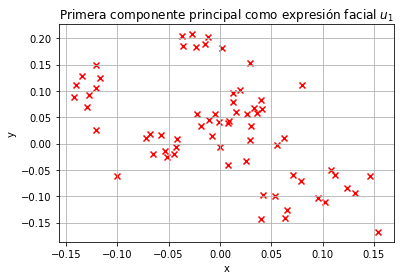

In [12]:
# Ahora vamos a graficar estos tres vectores propios como si fueran expresiones faciales (los índices dentro de la lísta de índices están en orden ascendente; los necesitamos en orden descendente (el mayor primero)).
u1 = v1[:,indices[2]]
u2 = v1[:,indices[1]]
u3 = v1[:,indices[0]]

X_u1 = []
Y_u1 = []

for i in range(len(u1)):
    # Si es par, es coordenada X, de lo contrario, es coordenada Y
    if i%2 == 0:
        X_u1.append(u1[i])
    elif i%2 != 0:
        Y_u1.append(u1[i])

# Gráfica de la primera componente principal como expresión facial
plt.figure()
plt.grid()
plt.scatter(np.array(Y_u1), -np.array(X_u1), color='red', marker='x')
plt.title('Primera componente principal como expresión facial $u_1$')
plt.xlabel('x')
plt.ylabel('y')

print(f'Varianza que aporta esta componente principal: {w1[indices[2]]}\n')

Varianza que aporta esta componente principal: 0.0001047094633929407



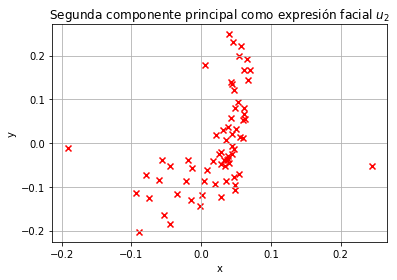

In [13]:
X_u2 = []
Y_u2 = []

for i in range(len(u2)):
    # Si es par, es coordenada X, de lo contrario, es coordenada Y
    if i%2 == 0:
        X_u2.append(u2[i])
    elif i%2 != 0:
        Y_u2.append(u2[i])

# Gráfica de la segunda componente principal como expresión facial
plt.figure()
plt.grid()
plt.scatter(np.array(Y_u2), -np.array(X_u2), color='red', marker='x')
plt.title('Segunda componente principal como expresión facial $u_2$')
plt.xlabel('x')
plt.ylabel('y')

print(f'Varianza que aporta esta componente principal: {w1[indices[1]]}\n')

Varianza que aporta esta componente principal: 8.605500174788825e-05



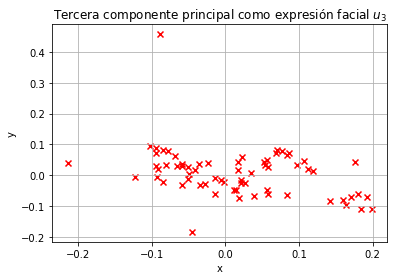

In [14]:
X_u3 = []
Y_u3 = []

for i in range(len(u3)):
    # Si es par, es coordenada X, de lo contrario, es coordenada Y
    if i%2 == 0:
        X_u3.append(u3[i])
    elif i%2 != 0:
        Y_u3.append(u3[i])

# Gráfica de la tercera componente principal como expresión facial
plt.figure()
plt.grid()
plt.scatter(np.array(Y_u3), -np.array(X_u3), color='red', marker='x')
plt.title('Tercera componente principal como expresión facial $u_3$')
plt.xlabel('x')
plt.ylabel('y')

print(f'Varianza que aporta esta componente principal: {w1[indices[0]]}\n')

### Se puede decir que el vector principal $u_1$ representa la base que captura la máxima variabilidad de todas las expresiones faciales, mientras que los siguientes dos vectores $u_2$ y $u_3$ son los vectores que le siguen, es decir, las bases que capturan la segunda y tercera máxima variabilidad de todas las expresiones faciales.

## d) Utilizando los dos primeros vectores principales, mapee cada expresión facial a un subespacio en dos dimensiones.

La primera dimensión debe corresponder a la proyección de mayor varianza, y la segunda dimensión debe corresponder a la segunda proyección de mayor varianza. Utilizando la función de Matlab scatter o su equivalente en Python grafique los datos 2-dimensionales coloreados, donde el color asignado depende de las etiquetas originales asociadas a las emociones. Interprete estos datos basado en el conocimiento que tienen sobre PCA.

Text(0, 0.5, 'Componente principal 2')

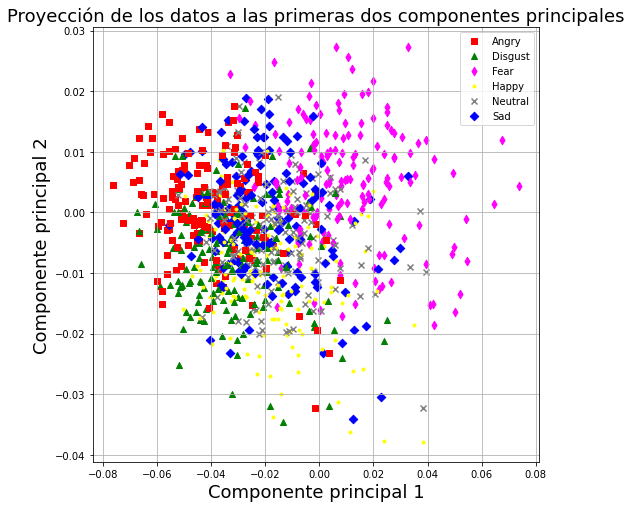

In [15]:
# Nuestro espacio original es de 134 dimensiones, vamos a encontrar una proyección de los datos en r = 2 dimensiones.end=
r = 2

# Creamos el vector z_i = Ar*x_i para cada dato. Vamos a guardarlos en una matriz grande Z (134x974).
Z = np.zeros((r, len(datos_media)))

# Creamos la matriz Ar, una matriz cuyas filas son los vectores de componentes principales transpuestos (u_i^T).
Ar = np.array([u1,u2])

# Llenamos la matriz Z con su z_i correspondiente.
for i in range(np.shape(Z)[1]):
    z = Ar@columna(matriz_carac[:,i])
    Z[:,i] = z.T

# Creamos listas para saber qué índices dentro de nuestra lista de datos corresponden a qué expresión facial
neutral = []
indicesneutral = []

happy = []
indiceshappy = []

sad = []
indicessad = []

fear = []
indicesfear = []

angry = []
indicesangry = []

disgust = []
indicesdisgust = []

# Llenamos dichas listas de índices
for file in os.listdir(dataDir):
    if (file[8] == "n"):
        neutral.append(file)
        indicesneutral.append(os.listdir(dataDir).index(file))
    elif (file[8] == "h"):   
        happy.append(file)
        indiceshappy.append(os.listdir(dataDir).index(file))
    elif (file[8] == "s"):
        sad.append(file)
        indicessad.append(os.listdir(dataDir).index(file))
    elif (file[8] == "f"):
        fear.append(file)
        indicesfear.append(os.listdir(dataDir).index(file))
    elif (file[8] == "a"):
        angry.append(file) 
        indicesangry.append(os.listdir(dataDir).index(file))
    elif (file[8] == "d"):
        disgust.append(file)
        indicesdisgust.append(os.listdir(dataDir).index(file))

plt.figure(figsize=(8, 8))
plt.grid()
for j in range(np.shape(Z)[1]):
    if j in indicesneutral:
        plt.scatter(Z[:,j][0], Z[:,j][1], color='grey', marker='x')
    elif j in indiceshappy:
        plt.scatter(Z[:,j][0], Z[:,j][1], color='yellow', marker='.')
    elif j in indicessad:
        plt.scatter(Z[:,j][0], Z[:,j][1], color='blue', marker='D')
    elif j in indicesfear:
        plt.scatter(Z[:,j][0], Z[:,j][1], color='magenta', marker='d')
    elif j in indicesangry:
        plt.scatter(Z[:,j][0], Z[:,j][1], color='red', marker='s')
    elif j in indicesdisgust:
        plt.scatter(Z[:,j][0], Z[:,j][1], color='green', marker='^')

plt.title('Proyección de los datos a las primeras dos componentes principales', fontsize=18)
plt.legend(['Angry', 'Disgust', 'Fear', 'Happy', 'Neutral', 'Sad'])
plt.xlabel('Componente principal 1', fontsize=18)
plt.ylabel('Componente principal 2', fontsize=18)


En la figura anterior se puede apreciar la distribución de los datos de las expresiones faciales en un espacio 2-dimensional, agrupados por su respectiva expresión facial. Se puede notar que los datos se traslapan bastante hacia el centro de la gráfica, pues estos landmarks son muy similares, aunque correspondan a diferentes expresiones faciales. 

Para los landmarks de la expresión 'Fear' y algunos de la expresión 'Angry', se puede notar que estos se diferencian mucho más que los otros, pues la mayoría de estos datos no están traslapados con las demás expresiones. Además, se puede notar cómo hay expresiones de ciertas expresinoes faciales que están bastante alejadas de sus respectivos clusters, por tener alguna particularidad de sus respectivos landmarks en comparación con los demás de su misma expresión facial.  